In [ ]:
# Install the surprise library
!pip install scikit-surprise


In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import nltk
import random
from surprise import Dataset, Reader
from scipy import stats
from sklearn.model_selection import train_test_split
from sklearn.feature_extraction.text import TfidfVectorizer
from surprise.model_selection import GridSearchCV
from surprise.prediction_algorithms.knns import KNNWithZScore
from surprise import Reader, Dataset, SVD, KNNBasic, KNNWithMeans, KNNWithZScore, NormalPredictor
from surprise import NMF
from surprise import NormalPredictor
from sklearn.metrics.pairwise import cosine_similarity
from surprise.model_selection import train_test_split, cross_validate
from surprise import accuracy
from nltk.corpus import stopwords
from nltk.tokenize import word_tokenize
from nltk.stem import PorterStemmer
from wordcloud import WordCloud

nltk.download('punkt')
nltk.download('stopwords')



[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


True

#Data Visualiztion

In [ ]:
df = pd.read_csv('amazon.csv')
df.head()

,product_id,product_name,category,discounted_price,actual_price,discount_percentage,rating,rating_count,about_product,user_id,user_name,review_id,review_title,review_content,img_link,product_link
0,B07JW9H4J1,Wayona Nylon Braided USB to Lightning Fast Cha...,Computers&Accessories|Accessories&Peripherals|...,₹399,"₹1,099",64%,4.2,"24,269",High Compatibility : Compatible With iPhone 12...,"AG3D6O4STAQKAY2UVGEUV46KN35Q,AHMY5CWJMMK5BJRBB...","Manav,Adarsh gupta,Sundeep,S.Sayeed Ahmed,jasp...","R3HXWT0LRP0NMF,R2AJM3LFTLZHFO,R6AQJGUP6P86,R1K...","Satisfied,Charging is really fast,Value for mo...",Looks durable Charging is fine tooNo complains...,https://m.media-amazon.com/images/W/WEBP_40237...,https://www.amazon.in/Wayona-Braided-WN3LG1-Sy...
1,B098NS6PVG,Ambrane Unbreakable 60W / 3A Fast Charging 1.5...,Computers&Accessories|Accessories&Peripherals|...,₹199,₹349,43%,4.0,"43,994","Compatible with all Type C enabled devices, be...","AECPFYFQVRUWC3KGNLJIOREFP5LQ,AGYYVPDD7YG7FYNBX...","ArdKn,Nirbhay kumar,Sagar Viswanathan,Asp,Plac...","RGIQEG07R9HS2,R1SMWZQ86XIN8U,R2J3Y1WL29GWDE,RY...","A Good Braided Cable for Your Type C Device,Go...",I ordered this cable to connect my phone to An...,https://m.media-amazon.com/images/W/WEBP_40237...,https://www.amazon.in/Ambrane-Unbreakable-Char...
2,B096MSW6CT,Sounce Fast Phone Charging Cable & Data Sync U...,Computers&Accessories|Accessories&Peripherals|...,₹199,"₹1,899",90%,3.9,"7,928",【 Fast Charger& Data Sync】-With built-in safet...,"AGU3BBQ2V2DDAMOAKGFAWDDQ6QHA,AESFLDV2PT363T2AQ...","Kunal,Himanshu,viswanath,sai niharka,saqib mal...","R3J3EQQ9TZI5ZJ,R3E7WBGK7ID0KV,RWU79XKQ6I1QF,R2...","Good speed for earlier versions,Good Product,W...","Not quite durable and sturdy,https://m.media-a...",https://m.media-amazon.com/images/W/WEBP_40237...,https://www.amazon.in/Sounce-iPhone-Charging-C...
3,B08HDJ86NZ,boAt Deuce USB 300 2 in 1 Type-C & Micro USB S...,Computers&Accessories|Accessories&Peripherals|...,₹329,₹699,53%,4.2,"94,363",The boAt Deuce USB 300 2 in 1 cable is compati...,"AEWAZDZZJLQUYVOVGBEUKSLXHQ5A,AG5HTSFRRE6NL3M5S...","Omkar dhale,JD,HEMALATHA,Ajwadh a.,amar singh ...","R3EEUZKKK9J36I,R3HJVYCLYOY554,REDECAZ7AMPQC,R1...","Good product,Good one,Nice,Really nice product...","Good product,long wire,Charges good,Nice,I bou...",https://m.media-amazon.com/images/I/41V5FtEWPk...,https://www.amazon.in/Deuce-300-Resistant-Tang...
4,B08CF3B7N1,Portronics Konnect L 1.2M Fast Charging 3A 8 P...,Computers&Accessories|Accessories&Peripherals|...,₹154,₹399,61%,4.2,"16,905",[CHARGE & SYNC FUNCTION]- This cable comes wit...,"AE3Q6KSUK5P75D5HFYHCRAOLODSA,AFUGIFH5ZAFXRDSZH...","rahuls6099,Swasat Borah,Ajay Wadke,Pranali,RVK...","R1BP4L2HH9TFUP,R16PVJEXKV6QZS,R2UPDB81N66T4P,R...","As good as original,Decent,Good one for second...","Bought this instead of original apple, does th...",https://m.media-amazon.com/images/W/WEBP_40237...,https://www.amazon.in/Portronics-Konnect-POR-1...


In [ ]:
df.tail()

,product_id,product_name,category,discounted_price,actual_price,discount_percentage,rating,rating_count,about_product,user_id,user_name,review_id,review_title,review_content,img_link,product_link
1460,B08L7J3T31,Noir Aqua - 5pcs PP Spun Filter + 1 Spanner | ...,Home&Kitchen|Kitchen&HomeAppliances|WaterPurif...,₹379,₹919,59%,4,"1,090",SUPREME QUALITY 90 GRAM 3 LAYER THIK PP SPUN F...,"AHITFY6AHALOFOHOZEOC6XBP4FEA,AFRABBODZJZQB6Z4U...","Prabha ds,Raghuram bk,Real Deal,Amazon Custome...","R3G3XFHPBFF0E8,R3C0BZCD32EIGW,R2EBVBCN9QPD9R,R...","Received the product without spanner,Excellent...","I received product without spanner,Excellent p...",https://m.media-amazon.com/images/I/41fDdRtjfx...,https://www.amazon.in/Noir-Aqua-Spanner-Purifi...
1461,B01M6453MB,Prestige Delight PRWO Electric Rice Cooker (1 ...,Home&Kitchen|Kitchen&HomeAppliances|SmallKitch...,"₹2,280","₹3,045",25%,4.1,"4,118","230 Volts, 400 watts, 1 Year","AFG5FM3NEMOL6BNFRV2NK5FNJCHQ,AGEINTRN6Z563RMLH...","Manu Bhai,Naveenpittu,Evatira Sangma,JAGANNADH...","R3DDL2UPKQ2CK9,R2SYYU1OATVIU5,R1VM993161IYRW,R...","ok,everything was good couldn't return bcoz I ...","ok,got everything as mentioned but the measuri...",https://m.media-amazon.com/images/I/41gzDxk4+k...,https://www.amazon.in/Prestige-Delight-PRWO-1-...
1462,B009P2LIL4,Bajaj Majesty RX10 2000 Watts Heat Convector R...,"Home&Kitchen|Heating,Cooling&AirQuality|RoomHe...","₹2,219","₹3,080",28%,3.6,468,International design and styling|Two heat sett...,"AGVPWCMAHYQWJOQKMUJN4DW3KM5Q,AF4Q3E66MY4SR7YQZ...","Nehal Desai,Danish Parwez,Amazon Customer,Amaz...","R1TLRJVW4STY5I,R2O455KRN493R1,R3Q5MVGBRIAS2G,R...","very good,Work but front melt after 2 month,Go...","plastic but cool body ,u have to find sturdy s...",https://m.media-amazon.com/images/W/WEBP_40237...,https://www.amazon.in/Bajaj-RX-10-2000-Watt-Co...
1463,B00J5DYCCA,Havells Ventil Air DSP 230mm Exhaust Fan (Pist...,"Home&Kitchen|Heating,Cooling&AirQuality|Fans|E...","₹1,399","₹1,890",26%,4,"8,031",Fan sweep area: 230 MM ; Noise level: (40 - 45...,"AF2JQCLSCY3QJATWUNNHUSVUPNQQ,AFDMLUXC5LS5RXDJS...","Shubham Dubey,E.GURUBARAN,Mayank S.,eusuf khan...","R39Q2Y79MM9SWK,R3079BG1NIH6MB,R29A31ZELTZNJM,R...","Fan Speed is slow,Good quality,Good product,go...",I have installed this in my kitchen working fi...,https://m.media-amazon.com/images/W/WEBP_40237...,https://www.amazon.in/Havells-Ventilair-230mm-...
1464,B01486F4G6,Borosil Jumbo 1000-Watt Grill Sandwich Maker (...,Home&Kitchen|Kitchen&HomeAppliances|SmallKitch...,"₹2,863","₹3,690",22%,4.3,"6,987","Brand-Borosil, Specification â€“ 23V ~ 5Hz;1 W...","AFGW5PT3R6ZAVQR4Y5MWVAKBZAYA,AG7QNJ2SCS5VS5VYY...","Rajib,Ajay B,Vikas Kahol,PARDEEP,Anindya Prama...","R20RBRZ0WEUJT9,ROKIFK9R2ISSE,R30EEG2FNJSN5I,R2...","Works perfect,Ok good product,Nice Product. Re...",It does it job perfectly..only issue is temp c...,https://m.media-amazon.com/images/W/WEBP_40237...,https://www.amazon.in/Borosil-Jumbo-1000-Watt-...


In [ ]:
#to view all columns
df.describe(include='all')

,product_id,product_name,category,discounted_price,actual_price,discount_percentage,rating,rating_count,about_product,user_id,user_name,review_id,review_title,review_content,img_link,product_link
count,1465,1465,1465,1465,1465,1465,1465,1463,1465,1465,1465,1465,1465,1465,1465,1465
unique,1351,1337,211,550,449,92,28,1143,1293,1194,1194,1194,1194,1212,1412,1465
top,B07JW9H4J1,"Fire-Boltt Ninja Call Pro Plus 1.83"" Smart Wat...",Computers&Accessories|Accessories&Peripherals|...,₹199,₹999,50%,4.1,"9,378",[CHARGE & SYNC FUNCTION]- This cable comes wit...,"AHIKJUDTVJ4T6DV6IUGFYZ5LXMPA,AE55KTFVNXYFD5FPY...","$@|\|TO$|-|,Sethu madhav,Akash Thakur,Burger P...","R3F4T5TRYPTMIG,R3DQIEC603E7AY,R1O4Z15FD40PV5,R...","Worked on iPhone 7 and didn’t work on XR,Good ...","I am not big on camera usage, personally. I wa...",https://m.media-amazon.com/images/I/413sCRKobN...,https://www.amazon.in/Wayona-Braided-WN3LG1-Sy...
freq,3,5,233,53,120,56,244,9,6,10,10,10,10,8,3,1


In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1465 entries, 0 to 1464
Data columns (total 16 columns):
 #   Column               Non-Null Count  Dtype 
---  ------               --------------  ----- 
 0   product_id           1465 non-null   object
 1   product_name         1465 non-null   object
 2   category             1465 non-null   object
 3   discounted_price     1465 non-null   object
 4   actual_price         1465 non-null   object
 5   discount_percentage  1465 non-null   object
 6   rating               1465 non-null   object
 7   rating_count         1463 non-null   object
 8   about_product        1465 non-null   object
 9   user_id              1465 non-null   object
 10  user_name            1465 non-null   object
 11  review_id            1465 non-null   object
 12  review_title         1465 non-null   object
 13  review_content       1465 non-null   object
 14  img_link             1465 non-null   object
 15  product_link         1465 non-null   object
dtypes: obj

In [ ]:
#to check for missing values
df.isnull().sum()

product_id             0
product_name           0
category               0
discounted_price       0
actual_price           0
discount_percentage    0
rating                 0
rating_count           2
about_product          0
user_id                0
user_name              0
review_id              0
review_title           0
review_content         0
img_link               0
product_link           0
dtype: int64

In [ ]:
#To check each column's data type
df.dtypes

product_id             object
product_name           object
category               object
discounted_price       object
actual_price           object
discount_percentage    object
rating                 object
rating_count           object
about_product          object
user_id                object
user_name              object
review_id              object
review_title           object
review_content         object
img_link               object
product_link           object
dtype: object

In [ ]:
#Only the columns that has numerical values would be converted to a numeric data type.
#indicates which columns to convert to numeric types, because the values are suppose to be in numbers
# which are discount_price , actual_price and rating_count, etc...
# then converting all sign, commas, dollar signs, and percentage signs, to numeric values
numeric_cols = ['discounted_price', 'actual_price', 'discount_percentage', 'rating_count', 'rating']
df[numeric_cols] = df[numeric_cols].astype(str)
df[numeric_cols] = df[numeric_cols].apply(lambda x: x.str.replace(',', '').str.replace('$', '').str.replace('%', '')).apply(pd.to_numeric, errors='coerce')
print(df[numeric_cols].dtypes)


discounted_price       float64
actual_price           float64
discount_percentage      int64
rating_count           float64
rating                 float64
dtype: object


In [ ]:
#Updataed Data Types
print(df.dtypes)

product_id              object
product_name            object
category                object
discounted_price       float64
actual_price           float64
discount_percentage      int64
rating                 float64
rating_count           float64
about_product           object
user_id                 object
user_name               object
review_id               object
review_title            object
review_content          object
img_link                object
product_link            object
dtype: object


#Note
mean: an average value.

std: The standard deviation, which calculates how widely the numbers are distributed.

min: The minimum value.

25%: The first quartile, sometimes referred to as the 25th percentile.

50%: The second quartile, sometimes referred to as the median, or the 50th percentile.

75 percentile: The third quartile, or 75th percentile.

max: the maximum  value.


In [ ]:
#To check the statistical summary in the dataframe df
df.describe()

,discounted_price,actual_price,discount_percentage,rating,rating_count
count,0.0,0.0,1465.000000,1464.000000,1463.000000
mean,NaN,NaN,47.691468,4.096585,18295.541353
std,NaN,NaN,21.635905,0.291674,42753.864952
min,NaN,NaN,0.000000,2.000000,2.000000
25%,NaN,NaN,32.000000,4.000000,1186.000000
50%,NaN,NaN,50.000000,4.100000,5179.000000
75%,NaN,NaN,63.000000,4.300000,17336.500000
max,NaN,NaN,94.000000,5.000000,426973.000000


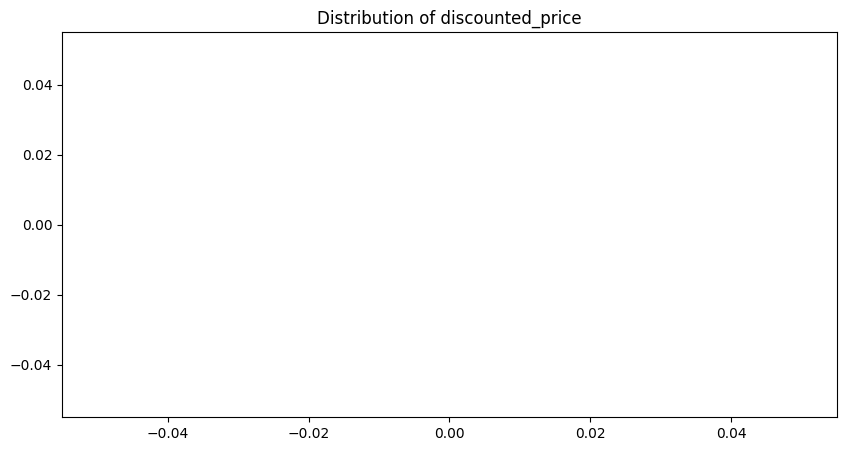

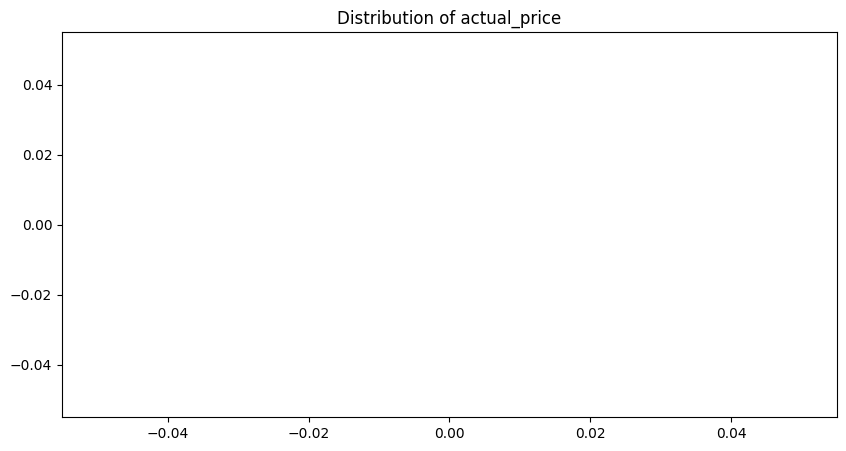

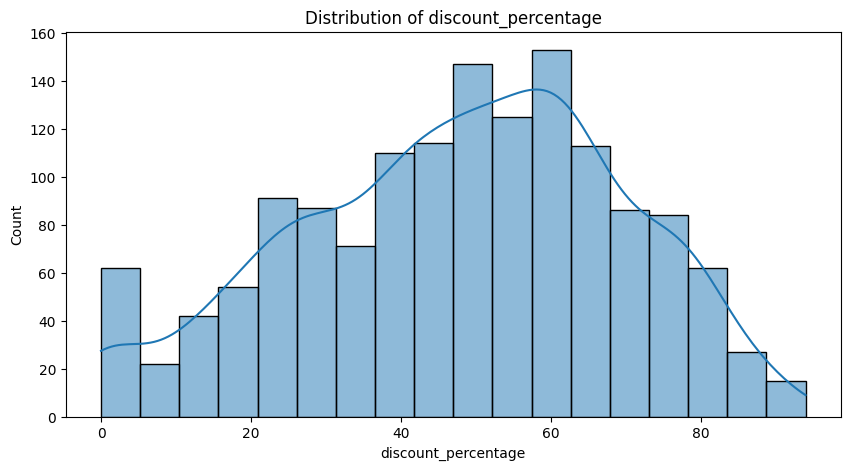

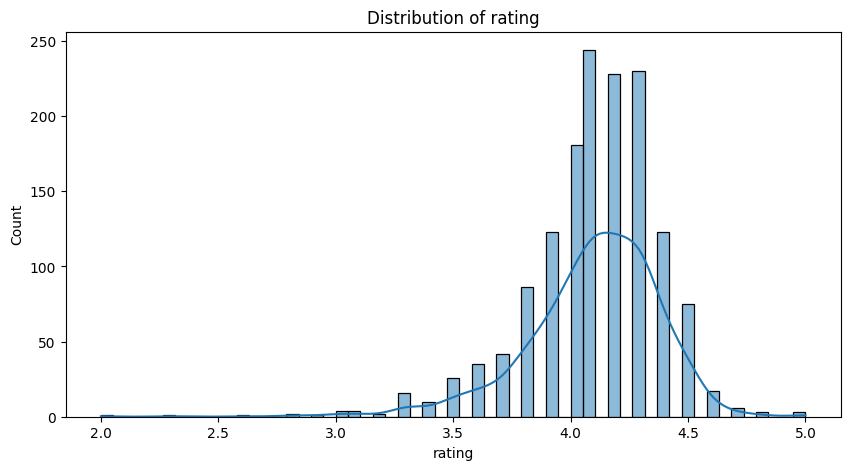

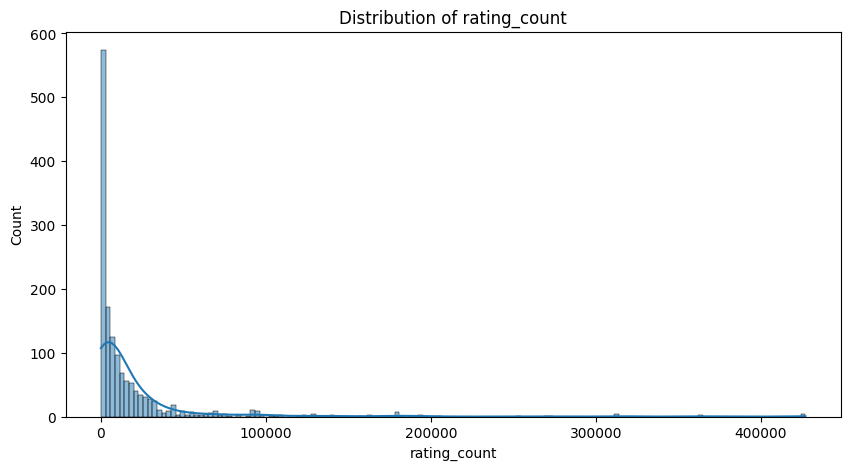

In [ ]:
#To visualize the numeric data distribution and  exmine the dataset
numerical_cols = ['discounted_price', 'actual_price', 'discount_percentage', 'rating', 'rating_count']
for col in numerical_cols:
  plt.figure(figsize=(10,5))
  sns.histplot(df[col].dropna(), kde=True)
  plt.title(f'Distribution of {col}')
  plt.show()

In [ ]:
#The fact that the columns product_id, user_id, review_id, img_link, and product_link are still of object type
#means that their data are probably not numeric. Most likely, these columns are text fields or identifiers
# which make them unsuitable for correlation analysis.
df.dtypes

product_id              object
product_name            object
category                object
discounted_price       float64
actual_price           float64
discount_percentage      int64
rating                 float64
rating_count           float64
about_product           object
user_id                 object
user_name               object
review_id               object
review_title            object
review_content          object
img_link                object
product_link            object
dtype: object

#Correlation Matrix

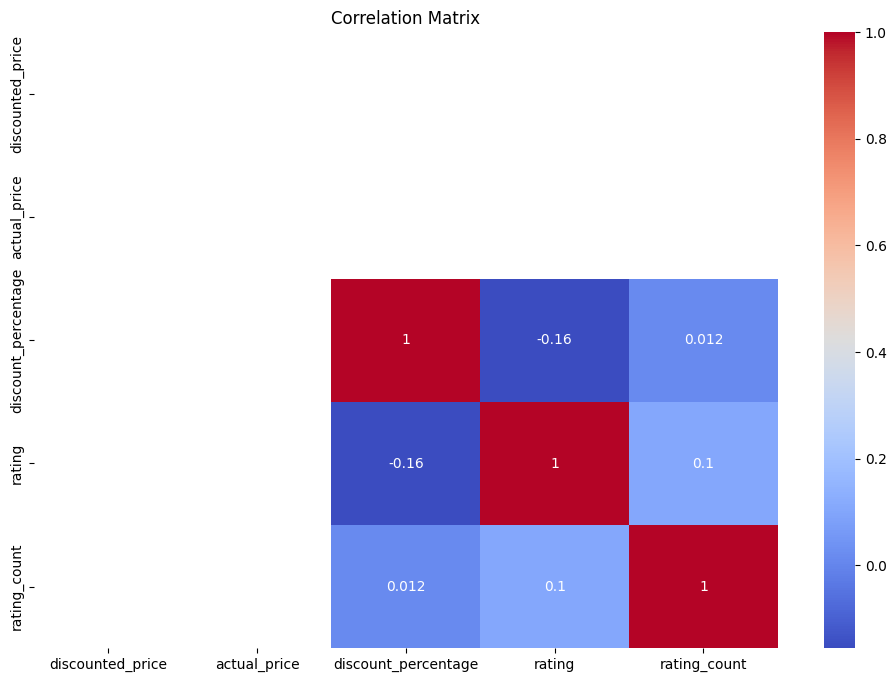

In [ ]:
#To visualise the correlation Matrix, we have to drop  non-numeric values and the columns we dont need
#so we procede with the column that are suitable
numeric_df = df.select_dtypes(include=['float64', 'int64'])
correlation_matrix = numeric_df.corr()
plt.figure(figsize=(12, 8))
sns.heatmap(correlation_matrix, annot=True, cmap= 'coolwarm')
plt.title('Correlation Matrix')
plt.show()

#Scatter Plot

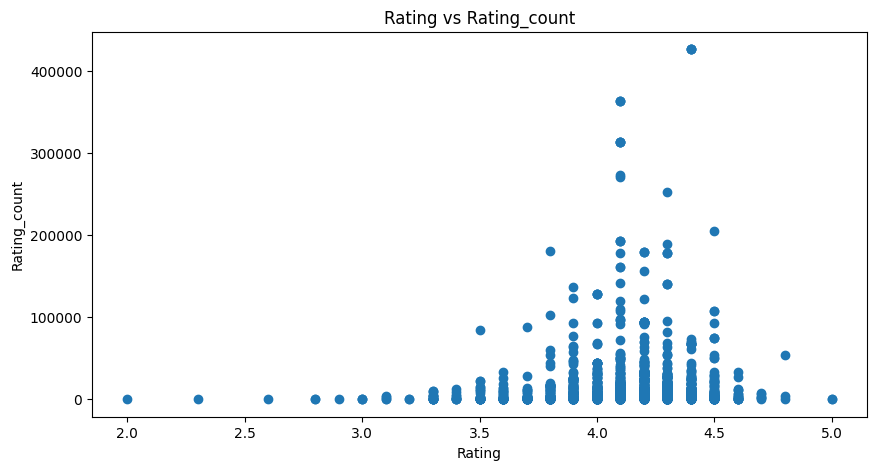

In [ ]:
#To visualise the Scatter Plots
plt.figure(figsize=(10, 5))
plt.scatter(df['rating'], df['rating_count'])
plt.xlabel('Rating')
plt.ylabel('Rating_count')
plt.title('Rating vs Rating_count')
plt.show()


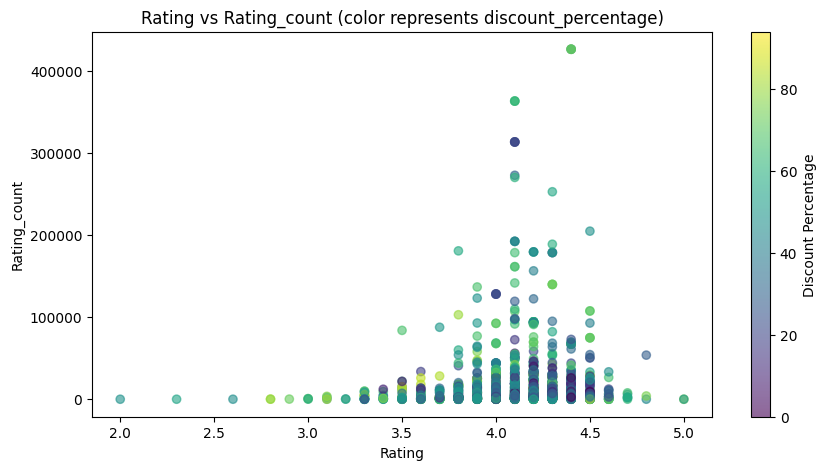

In [ ]:


# To visualize the Scatter Plots
plt.figure(figsize=(10, 5))
scatter = plt.scatter(df['rating'], df['rating_count'], c=df['discount_percentage'], cmap='viridis', alpha=0.6)
plt.xlabel('Rating')
plt.ylabel('Rating_count')
plt.title('Rating vs Rating_count (color represents discount_percentage)')
plt.colorbar(scatter, label='Discount Percentage')
plt.show()


#Box Plot

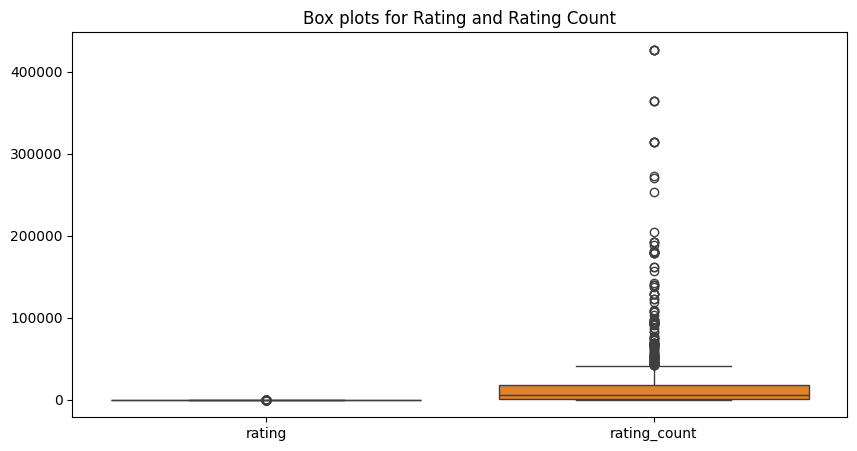

In [ ]:
#To visualise the box Plots
# and the only two colums with numerica values are rating and rating_count
plt.figure(figsize=(10, 5))
sns.boxplot(data=df[['rating', 'rating_count']])
plt.title('Box plots for Rating and Rating Count')
plt.show()


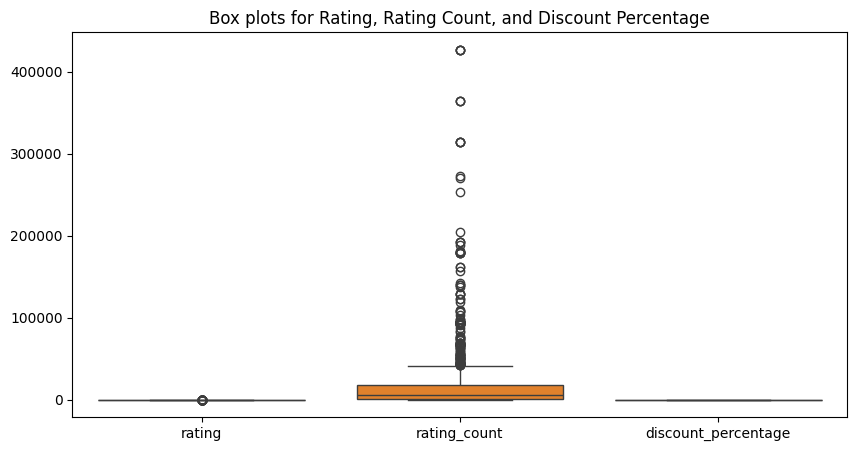

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

# To visualize the box plots
plt.figure(figsize=(10, 5))
sns.boxplot(data=df[['rating', 'rating_count', 'discount_percentage']])
plt.title('Box plots for Rating, Rating Count, and Discount Percentage')
plt.show()


In [ ]:
# Calculating Z-scores for rating and rating_count columns to Filter out outliers
#and the printing to show that the out l
df['z_score_rating'] = np.abs(stats.zscore(df['rating']))
df['z_score_rating_count'] = np.abs(stats.zscore(df['rating_count']))
df['z_score_discount_percentage'] = np.abs(stats.zscore(df['discount_percentage']))
df_clean = df[(df['z_score_rating'] < 3) & (df['z_score_rating_count'] < 3) & (df['z_score_discount_percentage'] < 3)]
print('original DataFrame shape:', df.shape)
print('Cleaned DataFrame shape:', df_clean.shape)


original DataFrame shape: (1465, 19)
Cleaned DataFrame shape: (0, 19)


In [ ]:
df['price_difference'] = df['actual_price'] - df['discounted_price']
df['rating_count_log'] = np.log1p(df['rating_count'])


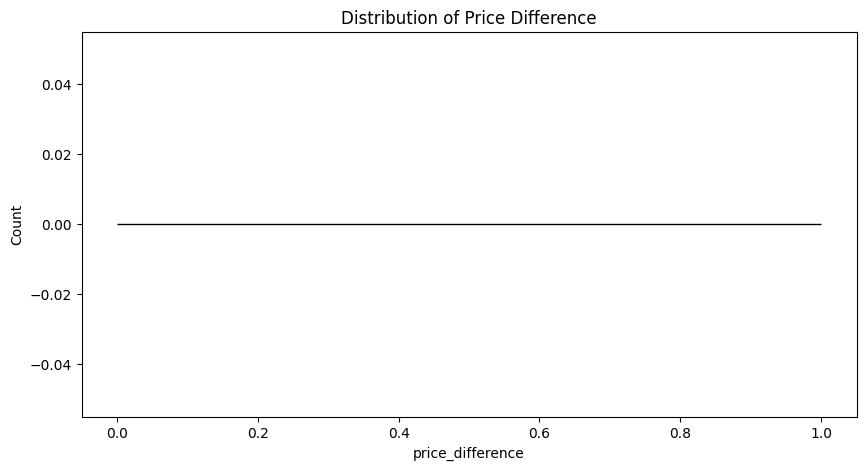

In [ ]:
plt.figure(figsize=(10, 5))
sns.histplot(df['price_difference'], kde=True)
plt.title('Distribution of Price Difference')
plt.show()


#Categorical plot,
for Columns that contain categorical varibles.
There are two types of categorical data: ordinal (has a natural order) and nominal (has no natural order). Typical categories of categorical data include


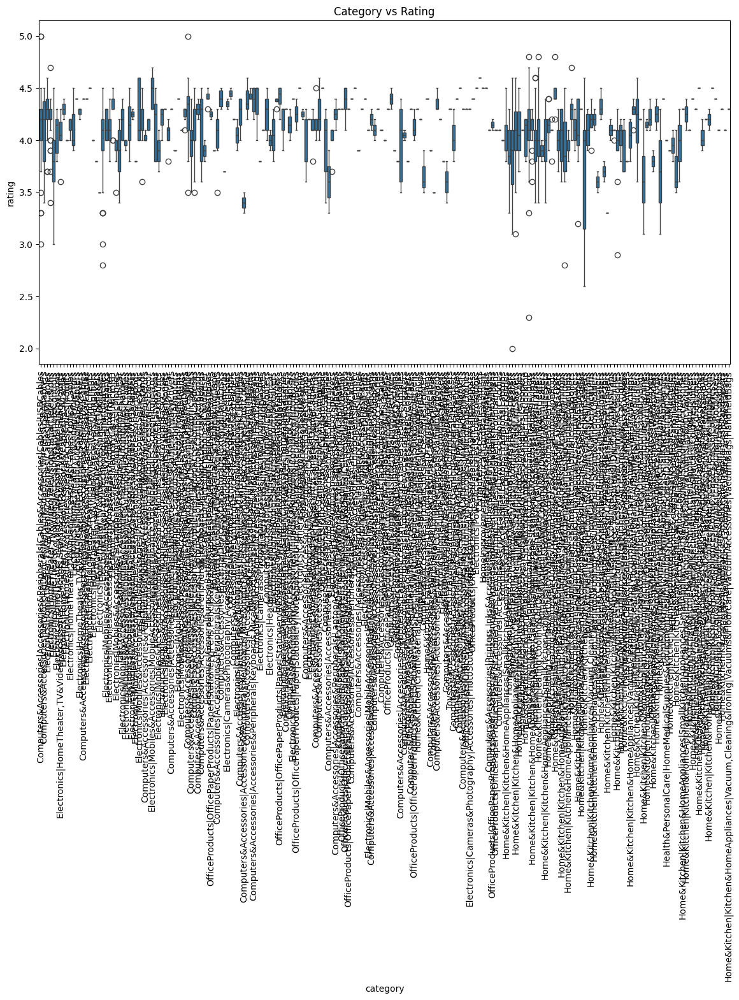

In [ ]:
plt.figure(figsize=(14, 7))
sns.boxplot(x='category', y='rating', data=df)
plt.title('Category vs Rating')
plt.xticks(rotation=90)
plt.show()


/usr/local/lib/python3.10/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 12289 (\N{IDEOGRAPHIC COMMA}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/usr/local/lib/python3.10/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 65292 (\N{FULLWIDTH COMMA}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)


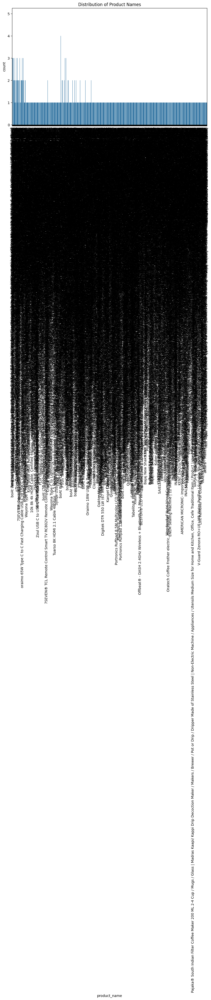

In [ ]:
#display product name-based distributions or relationships.
plt.figure(figsize=(10, 6))
sns.countplot(x='product_name', data=df)
plt.xticks(rotation=90)
plt.title('Distribution of Product Names')
plt.show()



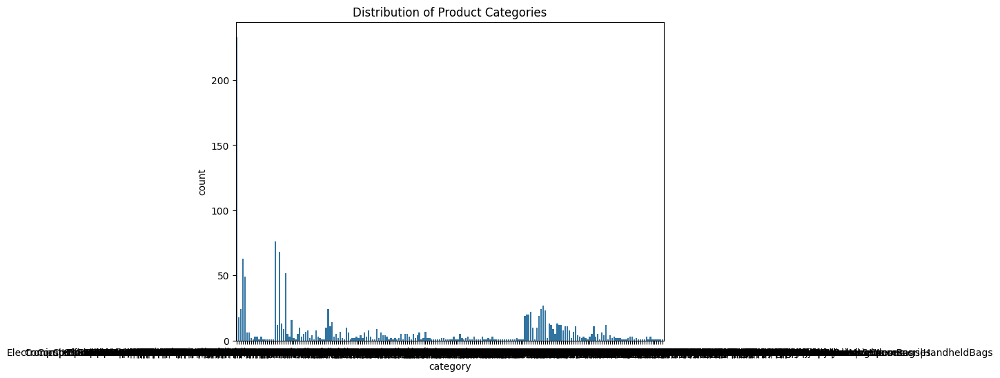

In [ ]:
#display correlations or distributions among several product categories.
plt.figure(figsize=(8, 6))
sns.countplot(x='category', data=df)
plt.title('Distribution of Product Categories')
plt.show()


/usr/local/lib/python3.10/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 2358 (\N{DEVANAGARI LETTER SHA}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/usr/local/lib/python3.10/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Matplotlib currently does not support Devanagari natively.
  fig.canvas.print_figure(bytes_io, **kw)
/usr/local/lib/python3.10/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 2381 (\N{DEVANAGARI SIGN VIRAMA}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/usr/local/lib/python3.10/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 2352 (\N{DEVANAGARI LETTER RA}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/usr/local/lib/python3.10/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 2368 (\N{DEVANAGARI VOWEL SIGN II}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/usr/local/lib/python3.10/dist-packages

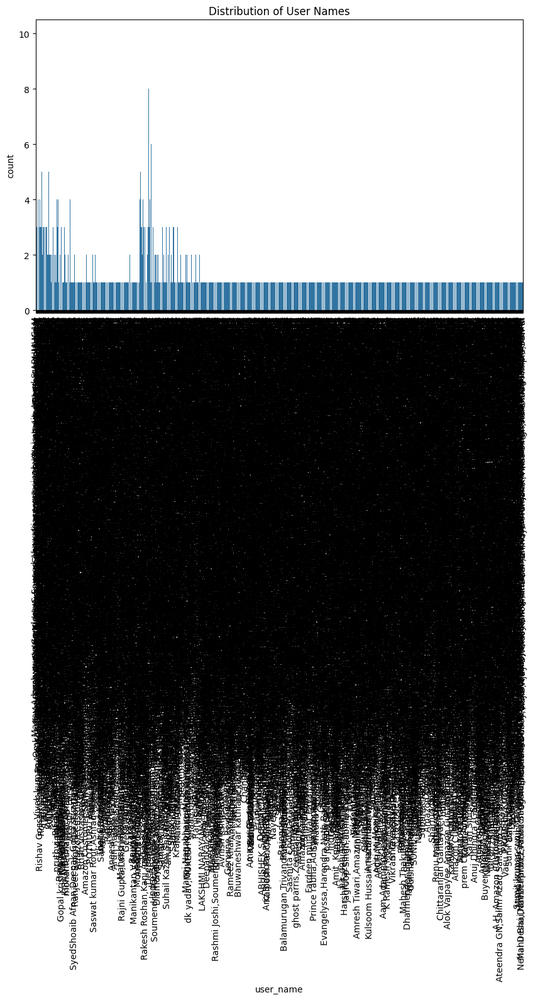

In [ ]:
#examine user-related information based on names, such as reviews or interactions
plt.figure(figsize=(10, 6))
sns.countplot(x='user_name', data=df)
plt.xticks(rotation=90)
plt.title('Distribution of User Names')
plt.show()


/usr/local/lib/python3.10/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 2325 (\N{DEVANAGARI LETTER KA}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/usr/local/lib/python3.10/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Matplotlib currently does not support Devanagari natively.
  fig.canvas.print_figure(bytes_io, **kw)
/usr/local/lib/python3.10/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 2366 (\N{DEVANAGARI VOWEL SIGN AA}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/usr/local/lib/python3.10/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 2375 (\N{DEVANAGARI VOWEL SIGN E}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/usr/local/lib/python3.10/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 2348 (\N{DEVANAGARI LETTER BA}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/usr/local/lib/python3.10/dist-packages

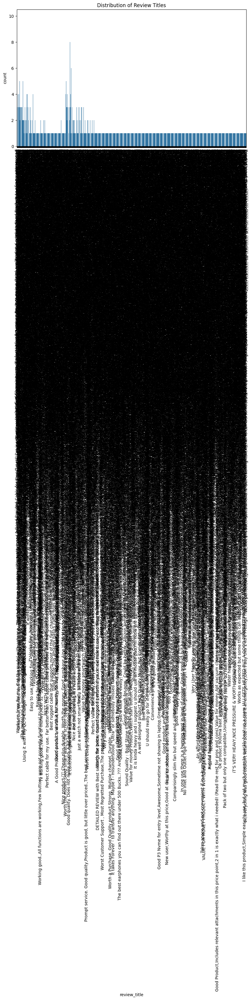

In [ ]:
#examine review title distributions or patterns
plt.figure(figsize=(10, 6))
sns.countplot(x='review_title', data=df)
plt.xticks(rotation=90)
plt.title('Distribution of Review Titles')
plt.show()


/usr/local/lib/python3.10/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 12304 (\N{LEFT BLACK LENTICULAR BRACKET}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/usr/local/lib/python3.10/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 12305 (\N{RIGHT BLACK LENTICULAR BRACKET}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/usr/local/lib/python3.10/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 129351 (\N{FIRST PLACE MEDAL}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/usr/local/lib/python3.10/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 65306 (\N{FULLWIDTH COLON}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/usr/local/lib/python3.10/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 65292 (\N{FULLWIDTH COMMA}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/usr/local/lib/python3.10/di

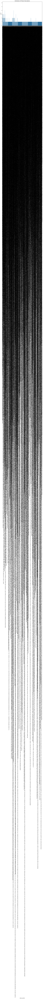

In [ ]:
#information regarding the product description
plt.figure(figsize=(10, 6))
sns.countplot(x='about_product', data=df)
plt.xticks(rotation=90)
plt.title('Distribution of Product Descriptions')
plt.show()


#Data Cleaning

In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1465 entries, 0 to 1464
Data columns (total 21 columns):
 #   Column                       Non-Null Count  Dtype  
---  ------                       --------------  -----  
 0   product_id                   1465 non-null   object 
 1   product_name                 1465 non-null   object 
 2   category                     1465 non-null   object 
 3   discounted_price             0 non-null      float64
 4   actual_price                 0 non-null      float64
 5   discount_percentage          1465 non-null   int64  
 6   rating                       1464 non-null   float64
 7   rating_count                 1463 non-null   float64
 8   about_product                1465 non-null   object 
 9   user_id                      1465 non-null   object 
 10  user_name                    1465 non-null   object 
 11  review_id                    1465 non-null   object 
 12  review_title                 1465 non-null   object 
 13  review_content    

In [ ]:
# Identify missing values in columns and use mean imputation to fill them in.
columns_with_missing_values = df.columns[df.isna().any()].tolist()
df[columns_with_missing_values] = df[columns_with_missing_values].fillna(df[columns_with_missing_values].mean())

In [ ]:
#to check for missing values
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1465 entries, 0 to 1464
Data columns (total 21 columns):
 #   Column                       Non-Null Count  Dtype  
---  ------                       --------------  -----  
 0   product_id                   1465 non-null   object 
 1   product_name                 1465 non-null   object 
 2   category                     1465 non-null   object 
 3   discounted_price             0 non-null      float64
 4   actual_price                 0 non-null      float64
 5   discount_percentage          1465 non-null   int64  
 6   rating                       1465 non-null   float64
 7   rating_count                 1465 non-null   float64
 8   about_product                1465 non-null   object 
 9   user_id                      1465 non-null   object 
 10  user_name                    1465 non-null   object 
 11  review_id                    1465 non-null   object 
 12  review_title                 1465 non-null   object 
 13  review_content    

In [ ]:
# List of affected columns
affected_columns = ['discounted_price', 'actual_price', 'z_score_rating', 'z_score_rating_count', 'price_difference']

# Drop the affected columns
df_clean = df.drop(affected_columns, axis=1)


In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1465 entries, 0 to 1464
Data columns (total 21 columns):
 #   Column                       Non-Null Count  Dtype  
---  ------                       --------------  -----  
 0   product_id                   1465 non-null   object 
 1   product_name                 1465 non-null   object 
 2   category                     1465 non-null   object 
 3   discounted_price             0 non-null      float64
 4   actual_price                 0 non-null      float64
 5   discount_percentage          1465 non-null   int64  
 6   rating                       1465 non-null   float64
 7   rating_count                 1465 non-null   float64
 8   about_product                1465 non-null   object 
 9   user_id                      1465 non-null   object 
 10  user_name                    1465 non-null   object 
 11  review_id                    1465 non-null   object 
 12  review_title                 1465 non-null   object 
 13  review_content    

In [ ]:
#to show that discounted_price', 'actual_price', 'z_score_rating', 'z_score_rating_count', 'price_difference'
#as been removed
df_clean

,product_id,product_name,category,discount_percentage,rating,rating_count,about_product,user_id,user_name,review_id,review_title,review_content,img_link,product_link,z_score_discount_percentage,rating_count_log
0,B07JW9H4J1,Wayona Nylon Braided USB to Lightning Fast Cha...,Computers&Accessories|Accessories&Peripherals|...,64,4.2,24269.0,High Compatibility : Compatible With iPhone 12...,"AG3D6O4STAQKAY2UVGEUV46KN35Q,AHMY5CWJMMK5BJRBB...","Manav,Adarsh gupta,Sundeep,S.Sayeed Ahmed,jasp...","R3HXWT0LRP0NMF,R2AJM3LFTLZHFO,R6AQJGUP6P86,R1K...","Satisfied,Charging is really fast,Value for mo...",Looks durable Charging is fine tooNo complains...,https://m.media-amazon.com/images/W/WEBP_40237...,https://www.amazon.in/Wayona-Braided-WN3LG1-Sy...,0.754029,10.096996
1,B098NS6PVG,Ambrane Unbreakable 60W / 3A Fast Charging 1.5...,Computers&Accessories|Accessories&Peripherals|...,43,4.0,43994.0,"Compatible with all Type C enabled devices, be...","AECPFYFQVRUWC3KGNLJIOREFP5LQ,AGYYVPDD7YG7FYNBX...","ArdKn,Nirbhay kumar,Sagar Viswanathan,Asp,Plac...","RGIQEG07R9HS2,R1SMWZQ86XIN8U,R2J3Y1WL29GWDE,RY...","A Good Braided Cable for Your Type C Device,Go...",I ordered this cable to connect my phone to An...,https://m.media-amazon.com/images/W/WEBP_40237...,https://www.amazon.in/Ambrane-Unbreakable-Char...,0.216911,10.691831
2,B096MSW6CT,Sounce Fast Phone Charging Cable & Data Sync U...,Computers&Accessories|Accessories&Peripherals|...,90,3.9,7928.0,【 Fast Charger& Data Sync】-With built-in safet...,"AGU3BBQ2V2DDAMOAKGFAWDDQ6QHA,AESFLDV2PT363T2AQ...","Kunal,Himanshu,viswanath,sai niharka,saqib mal...","R3J3EQQ9TZI5ZJ,R3E7WBGK7ID0KV,RWU79XKQ6I1QF,R2...","Good speed for earlier versions,Good Product,W...","Not quite durable and sturdy,https://m.media-a...",https://m.media-amazon.com/images/W/WEBP_40237...,https://www.amazon.in/Sounce-iPhone-Charging-C...,1.956146,8.978282
3,B08HDJ86NZ,boAt Deuce USB 300 2 in 1 Type-C & Micro USB S...,Computers&Accessories|Accessories&Peripherals|...,53,4.2,94363.0,The boAt Deuce USB 300 2 in 1 cable is compati...,"AEWAZDZZJLQUYVOVGBEUKSLXHQ5A,AG5HTSFRRE6NL3M5S...","Omkar dhale,JD,HEMALATHA,Ajwadh a.,amar singh ...","R3EEUZKKK9J36I,R3HJVYCLYOY554,REDECAZ7AMPQC,R1...","Good product,Good one,Nice,Really nice product...","Good product,long wire,Charges good,Nice,I bou...",https://m.media-amazon.com/images/I/41V5FtEWPk...,https://www.amazon.in/Deuce-300-Resistant-Tang...,0.245441,11.454915
4,B08CF3B7N1,Portronics Konnect L 1.2M Fast Charging 3A 8 P...,Computers&Accessories|Accessories&Peripherals|...,61,4.2,16905.0,[CHARGE & SYNC FUNCTION]- This cable comes wit...,"AE3Q6KSUK5P75D5HFYHCRAOLODSA,AFUGIFH5ZAFXRDSZH...","rahuls6099,Swasat Borah,Ajay Wadke,Pranali,RVK...","R1BP4L2HH9TFUP,R16PVJEXKV6QZS,R2UPDB81N66T4P,R...","As good as original,Decent,Good one for second...","Bought this instead of original apple, does th...",https://m.media-amazon.com/images/W/WEBP_40237...,https://www.amazon.in/Portronics-Konnect-POR-1...,0.615323,9.735424
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1460,B08L7J3T31,Noir Aqua - 5pcs PP Spun Filter + 1 Spanner | ...,Home&Kitchen|Kitchen&HomeAppliances|WaterPurif...,59,4.0,1090.0,SUPREME QUALITY 90 GRAM 3 LAYER THIK PP SPUN F...,"AHITFY6AHALOFOHOZEOC6XBP4FEA,AFRABBODZJZQB6Z4U...","Prabha ds,Raghuram bk,Real Deal,Amazon Custome...","R3G3XFHPBFF0E8,R3C0BZCD32EIGW,R2EBVBCN9QPD9R,R...","Received the product without spanner,Excellent...","I received product without spanner,Excellent p...",https://m.media-amazon.com/images/I/41fDdRtjfx...,https://www.amazon.in/Noir-Aqua-Spanner-Purifi...,0.522853,6.994850
1461,B01M6453MB,Prestige Delight PRWO Electric Rice Cooker (1 ...,Home&Kitchen|Kitchen&HomeAppliances|SmallKitch...,25,4.1,4118.0,"230 Volts, 400 watts, 1 Year","AFG5FM3NEMOL6BNFRV2NK5FNJCHQ,AGEINTRN6Z563RMLH...","Manu Bhai,Naveenpittu,Evatira Sangma,JAGANNADH...","R3DDL2UPKQ2CK9,R2SYYU1OATVIU5,R1VM993161IYRW,R...","ok,everything was good couldn't return bcoz I ...","ok,got everyt

In [ ]:
cleaned_columns = []

# Iterate over the columns of the cleaned DataFrame
for column in df_clean.columns:
    # Check if the column contains text data (assuming string data type)
    if df_clean[column].dtype == 'object':
        cleaned_columns.append(column)

# Print the list of cleaned columns
print(cleaned_columns)


['product_id', 'product_name', 'category', 'about_product', 'user_id', 'user_name', 'review_id', 'review_title', 'review_content', 'img_link', 'product_link']


#Outliers
Outliers in the numerical columns 'rating', 'rating_count', and 'discount_percentage' are identified and removed using the Z-score. The extreme values in these columns are then clipped to a given range, and a log transformation is applied to the 'rating_count' column to handle skewness.

Using a log transformation on the 'rating_count' column can help to reduce skewness in its distribution, especially if the data is substantially right-skewed. Log transformations are widely employed for numerical features with such skewness because they can make the data more symmetrical and easier to analyse statistically.



In [ ]:
# Define the numerical columns
numerical_columns = ['rating', 'rating_count', 'discount_percentage']
for col in numerical_columns:
    z_scores = stats.zscore(df[col])
    outlier_threshold = 3
    df = df[(np.abs(z_scores) < outlier_threshold)]

#Consider the valid value range for the data in the numerical columns.
#For instance, if negative numbers are not significant in your dataset, it is okay to declare a lower constraint of 0.
#since we dont have negative values we leave the lower_bound at 0
lower_bound = 0
upper_bound = 100
for col in numerical_columns:
    df[col] = df[col].clip(lower=lower_bound, upper=upper_bound)

# Apply log transformation to the 'rating_count' column
df['rating_count'] = np.log(df['rating_count'] + 1)  # Adding 1 to avoid log(0)




In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 1416 entries, 0 to 1464
Data columns (total 21 columns):
 #   Column                       Non-Null Count  Dtype  
---  ------                       --------------  -----  
 0   product_id                   1416 non-null   object 
 1   product_name                 1416 non-null   object 
 2   category                     1416 non-null   object 
 3   discounted_price             0 non-null      float64
 4   actual_price                 0 non-null      float64
 5   discount_percentage          1416 non-null   int64  
 6   rating                       1416 non-null   float64
 7   rating_count                 1416 non-null   float64
 8   about_product                1416 non-null   object 
 9   user_id                      1416 non-null   object 
 10  user_name                    1416 non-null   object 
 11  review_id                    1416 non-null   object 
 12  review_title                 1416 non-null   object 
 13  review_content         

In [ ]:
#To show the update
print(df.head())

   product_id                                       product_name  \
0  B07JW9H4J1  Wayona Nylon Braided USB to Lightning Fast Cha...   
1  B098NS6PVG  Ambrane Unbreakable 60W / 3A Fast Charging 1.5...   
2  B096MSW6CT  Sounce Fast Phone Charging Cable & Data Sync U...   
3  B08HDJ86NZ  boAt Deuce USB 300 2 in 1 Type-C & Micro USB S...   
4  B08CF3B7N1  Portronics Konnect L 1.2M Fast Charging 3A 8 P...   

                                            category  discounted_price  \
0  Computers&Accessories|Accessories&Peripherals|...               NaN   
1  Computers&Accessories|Accessories&Peripherals|...               NaN   
2  Computers&Accessories|Accessories&Peripherals|...               NaN   
3  Computers&Accessories|Accessories&Peripherals|...               NaN   
4  Computers&Accessories|Accessories&Peripherals|...               NaN   

   actual_price  discount_percentage  rating  rating_count  \
0           NaN                   64     4.2      4.615121   
1           NaN       


Tokenization: dividing text into distinct tokens.

Stopword removal: deleting common terms that add little meaning to the text, such as "the" and "and".
Stemming or lemmatization: reducing words to their base form (for example, "running" becomes "run").


Named Entity Recognition (NER) identifies specified entities such as names, locations, and organisations.
Part of Speech (POS). Tagging involves determining the grammatical category of each word (e.g., noun, verb, adjective).
Text normalisation entails changing all text to lowercase, deleting punctuation, etc.
Sentiment analysis is the process of determining the text's emotional tone or sentiment.

In [ ]:

def tokenize(text):
    tokens = word_tokenize(text)
    return tokens

In [ ]:

def remove_stopwords(tokens):
    stop_words = set(stopwords.words('english'))
    filtered_tokens = [word for word in tokens if word.lower() not in stop_words]
    return filtered_tokens

In [ ]:

def stem_words(tokens):
    stemmer = PorterStemmer()
    stemmed_tokens = [stemmer.stem(word) for word in tokens]
    return stemmed_tokens

In [ ]:

def preprocess_text(text):
    tokens = tokenize(text)
    filtered_tokens = remove_stopwords(tokens)
    stemmed_tokens = stem_words(filtered_tokens)
    return ' '.join(stemmed_tokens)

In [ ]:
df['review_title_processed'] = df['review_title'].apply(preprocess_text)
df['review_content_processed'] = df['review_content'].apply(preprocess_text)
df['about_product_processed'] = df['about_product'].apply(preprocess_text)

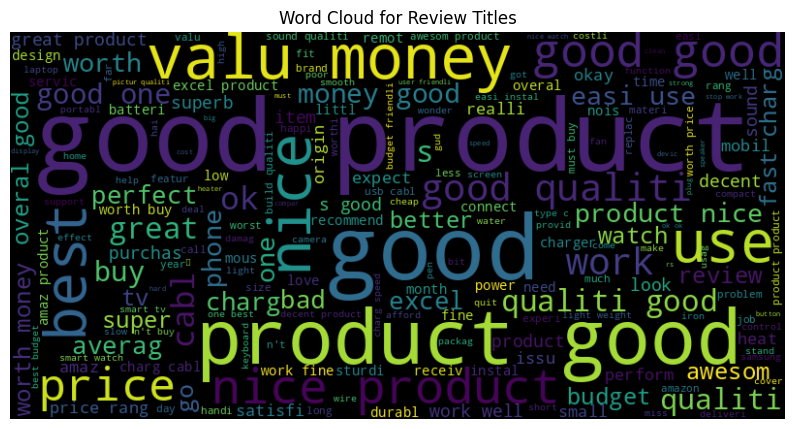

In [ ]:
text = ' '.join(df['review_title_processed'].tolist())
wordcloud = WordCloud(width=800, height=400).generate(text)
plt.figure(figsize=(10, 6))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')
plt.title('Word Cloud for Review Titles')
plt.show()

In [ ]:
vectorizer = TfidfVectorizer()
tfidf_matrix = vectorizer.fit_transform(df['review_content_processed'])

#Create a user-item interaction matrix.

 Separate the dataset into training and testing sets. Create user profiles to enable content-based filtering. Create product profiles for content-based filtering.

In [ ]:
import numpy as np
from sklearn.model_selection import train_test_split

user_item_array = user_item_interactions.values
train_data, test_data = train_test_split(user_item_array, test_size=0.2, random_state=42)

#Collaborative filtering (based on users or items)
using KNNWithZScore

In [ ]:
print(user_item_interactions.head())

product_id  index                                            user_id  \
0               0  AE22Y3KIS7SE6LI3HE2VS6WWPU4Q,AHWEYO2IJ5I5GDWZA...   
1               1  AE23RS3W7GZO7LHYKJU6KSKVM4MQ,AEQUNEY6GQOTEGUMS...   
2               2                       AE242TR3GQ6TYC6W4SJ5UYYKBTYQ   
3               3  AE27UOZENYSWCQVQRRUQIV2ZM7VA,AGMYSLV6NNOAYES25...   
4               4  AE2JTMRKTUOIVIZWS2WDGTMNTU4Q,AF4QXCB32VC2DVE7O...   

product_id  B002PD61Y4  B003B00484  B003L62T7W  B004IO5BMQ  B005LJQMCK  \
0                  0.0         0.0         0.0         0.0         0.0   
1                  0.0         0.0         0.0         0.0         0.0   
2                  0.0         0.0         0.0         0.0         0.0   
3                  0.0         0.0         0.0         0.0         0.0   
4                  0.0         0.0         0.0         0.0         0.0   

product_id  B005LJQMZC  B006LW0WDQ  B0073QGKAS  ...  B0BNV7JM5Y  B0BNVBJW2S  \
0                  0.0         0.0         

In [ ]:
print(user_item_interactions.columns)

Index(['index', 'user_id', 'B002PD61Y4', 'B003B00484', 'B003L62T7W',
       'B004IO5BMQ', 'B005LJQMCK', 'B005LJQMZC', 'B006LW0WDQ', 'B0073QGKAS',
       ...
       'B0BNV7JM5Y', 'B0BNVBJW2S', 'B0BNXFDTZ2', 'B0BP18W8TM', 'B0BP89YBC1',
       'B0BPBG712X', 'B0BPBXNQQT', 'B0BPCJM7TB', 'B0BQ3K23Y1', 'B0BR4F878Q'],
      dtype='object', name='product_id', length=1306)


In [ ]:
#user_item_interactions as DataFrame, so we reset the index to convert the user IDs from index to column.
# Melt the DataFrame to convert it from wide to long format
user_item_interactions = user_item_interactions.reset_index()
melted_df = pd.melt(user_item_interactions, id_vars='user_id', var_name='item_id', value_name='rating')

print(melted_df.head())

# load the data into the Surprise library and adjust the rating scale if needed.
reader = Reader(rating_scale=(1, 5))
data = Dataset.load_from_df(melted_df[['user_id', 'item_id', 'rating']], reader)
trainset = data.build_full_trainset()
algo = KNNWithZScore()
algo.fit(trainset)

                                             user_id  item_id  rating
0  AE22Y3KIS7SE6LI3HE2VS6WWPU4Q,AHWEYO2IJ5I5GDWZA...  level_0     0.0
1  AE23RS3W7GZO7LHYKJU6KSKVM4MQ,AEQUNEY6GQOTEGUMS...  level_0     1.0
2                       AE242TR3GQ6TYC6W4SJ5UYYKBTYQ  level_0     2.0
3  AE27UOZENYSWCQVQRRUQIV2ZM7VA,AGMYSLV6NNOAYES25...  level_0     3.0
4  AE2JTMRKTUOIVIZWS2WDGTMNTU4Q,AF4QXCB32VC2DVE7O...  level_0     4.0
Computing the msd similarity matrix...
Done computing similarity matrix.


#Evaluate the model


In [ ]:
from surprise.model_selection import cross_validate

# Evaluating the model using cross-validation
cross_validate(algo, data, measures=['RMSE', 'MAE'], cv=5, verbose=True)


Computing the msd similarity matrix...
Done computing similarity matrix.
Computing the msd similarity matrix...
Done computing similarity matrix.
Computing the msd similarity matrix...
Done computing similarity matrix.
Computing the msd similarity matrix...
Done computing similarity matrix.
Computing the msd similarity matrix...
Done computing similarity matrix.
Evaluating RMSE, MAE of algorithm KNNWithZScore on 5 split(s).

                  Fold 1  Fold 2  Fold 3  Fold 4  Fold 5  Mean    Std     
RMSE (testset)    25.6292 26.0900 26.0865 26.6106 25.8275 26.0488 0.3298  
MAE (testset)     1.9387  1.9512  1.9833  2.0422  1.9473  1.9725  0.0380  
Fit time          31.08   32.25   33.62   33.69   34.33   32.99   1.17    
Test time         260.91  267.93  266.73  272.40  270.74  267.74  3.96    


{'test_rmse': array([25.62924862, 26.08998515, 26.08650831, 26.61057229, 25.82745123]),
 'test_mae': array([1.93871455, 1.95121678, 1.98325266, 2.04222746, 1.94728446]),
 'fit_time': (31.077504873275757,
  32.24963641166687,
  33.61611747741699,
  33.68858623504639,
  34.3343300819397),
 'test_time': (260.9103229045868,
  267.9265043735504,
  266.72999572753906,
  272.40446424484253,
  270.7436890602112)}

#Predictions
BY selecting one user and build a recommendation for the user before we procceed to use other olgorithm so we can evelaute on different models

In [ ]:
# Predict the rating for a specific user and item
user_id = 'AE242TR3GQ6TYC6W4SJ5UYYKBTYQ'
item_id = 'B002PD61Y4'
prediction = algo.predict(user_id, item_id)
print(f"Predicted rating for user {user_id} and item {item_id}: {prediction.est}")


Predicted rating for user AE242TR3GQ6TYC6W4SJ5UYYKBTYQ and item B002PD61Y4: 1


In [ ]:
#training set and  Fitting the algorithm on the trainset
trainset = data.build_full_trainset()
algo.fit(trainset)

#the list of all item ids in the training set
all_items = trainset.all_items()
all_item_ids = [trainset.to_raw_iid(i) for i in all_items]

# Generating the top-N recommendations for a particular user
# Get 10 neighbors
# Convert recommended items' inner ids to raw ids.
user_inner_id = trainset.to_inner_uid(user_id)
user_ratings = algo.get_neighbors(user_inner_id, k=10)
recommended_items = [trainset.to_raw_iid(inner_id) for inner_id in user_ratings]

print(f"Top 10 recommendations for user {user_id}: {recommended_items}")


Computing the msd similarity matrix...
Done computing similarity matrix.
Top 10 recommendations for user AE242TR3GQ6TYC6W4SJ5UYYKBTYQ: ['index', 'B003B00484', 'level_0', 'B003L62T7W', 'B004IO5BMQ', 'B005LJQMCK', 'B005LJQMZC', 'B006LW0WDQ', 'B0073QGKAS', 'B0083T231O']


#Generate Recommendations
Generate top-N recommendations for a specific user.

In [ ]:
#training set and fitting the algorithm on the trainset
trainset = data.build_full_trainset()
algo.fit(trainset)

#list of all item ids in the training set
# Generating the top-N recommendations for a specific user
# Convert inner ids of recommended items to raw ids. and 10 neighbors
all_items = trainset.all_items()
all_item_ids = [trainset.to_raw_iid(i) for i in all_items]
user_inner_id = trainset.to_inner_uid(user_id)
user_ratings = algo.get_neighbors(user_inner_id, k=10)
recommended_items = [trainset.to_raw_iid(inner_id) for inner_id in user_ratings]

print(f"Top 10 recommendations for user {user_id}: {recommended_items}")


Computing the msd similarity matrix...
Done computing similarity matrix.
Top 10 recommendations for user AE242TR3GQ6TYC6W4SJ5UYYKBTYQ: ['index', 'B003B00484', 'level_0', 'B003L62T7W', 'B004IO5BMQ', 'B005LJQMCK', 'B005LJQMZC', 'B006LW0WDQ', 'B0073QGKAS', 'B0083T231O']


#Recommendation Quality
Comparing anticipated ratings to actual ratings to evalute suggestion quality further.
***RMSE (Root Mean Square Error)***,
***MAE (Mean Absolute Error)***

RMSE and MAE provide insights into the accuracy of predictions, with the former being more sensitive to big mistakes and the latter being more robust to outliers.


In [ ]:
from surprise import Dataset, Reader
from surprise.model_selection import train_test_split
from surprise import KNNWithZScore

# Assuming melted_df is your DataFrame with columns 'user_id', 'item_id', and 'rating'

# Load the data into the Surprise library
reader = Reader(rating_scale=(1, 5))  # Adjust the rating scale if needed
data = Dataset.load_from_df(melted_df[['user_id', 'item_id', 'rating']], reader)

# Split the data into train and test sets
trainset, testset = train_test_split(data, test_size=0.2, random_state=42)

# Initialize and train the algorithm
algo = KNNWithZScore()
algo.fit(trainset)

# Make predictions on the test set
predictions = algo.test(testset)

# Evaluate the results
from surprise import accuracy
accuracy.rmse(predictions)
accuracy.mae(predictions)

Computing the msd similarity matrix...
Done computing similarity matrix.
RMSE: 25.3090
MAE:  1.9490


1.9490072264103029

In [ ]:
# Train a different algorithm such as SVD
algo_svd = SVD()
algo_svd.fit(trainset)

# Evaluating the new algorithm
predictions_svd = algo_svd.test(testset)
rmse_svd = accuracy.rmse(predictions_svd)
mae_svd = accuracy.mae(predictions_svd)


RMSE: 25.7434
MAE:  5.8387


#Building with 4 Different Models

In [ ]:
# 1 KNNWithZScore
reader = Reader(rating_scale=(1, 5))
data = Dataset.load_from_df(df[['user_id', 'product_id', 'rating']], reader)

trainset, testset = train_test_split(data, test_size=0.25)
algo = KNNWithZScore()
algo.fit(trainset)
cv_results = cross_validate(algo, data, measures=['RMSE', 'MAE'], cv=5, verbose=True)
print(f"Average RMSE: {cv_results['test_rmse'].mean()}")
print(f"Average MAE: {cv_results['test_mae'].mean()}")
user_id = 'specific_user_id'
items = df['product_id'].unique()

recommendations = []
for item_id in items:
    if not df[(df['user_id'] == user_id) & (df['product_id'] == item_id)].empty:
        continue
    est = algo.predict(user_id, item_id).est
    recommendations.append((item_id, est))

recommendations.sort(key=lambda x: x[1], reverse=True)
top_10_recommendations = recommendations[:10]
print(f'Top 10 recommendations for user {user_id}: {top_10_recommendations}')


Computing the msd similarity matrix...
Done computing similarity matrix.
Computing the msd similarity matrix...
Done computing similarity matrix.
Computing the msd similarity matrix...
Done computing similarity matrix.
Computing the msd similarity matrix...
Done computing similarity matrix.
Computing the msd similarity matrix...
Done computing similarity matrix.
Computing the msd similarity matrix...
Done computing similarity matrix.
Evaluating RMSE, MAE of algorithm KNNWithZScore on 5 split(s).

                  Fold 1  Fold 2  Fold 3  Fold 4  Fold 5  Mean    Std     
RMSE (testset)    0.2594  0.2393  0.2521  0.2535  0.2455  0.2499  0.0069  
MAE (testset)     0.1850  0.1802  0.1829  0.1873  0.1771  0.1825  0.0036  
Fit time          0.15    0.04    0.04    0.04    0.04    0.07    0.04    
Test time         0.00    0.00    0.00    0.00    0.00    0.00    0.00    
Average RMSE: 0.24994659581481032
Average MAE: 0.1824859598948508
Top 10 recommendations for user specific_user_id: [('B07J

In [ ]:
# 2 SVD

reader = Reader(rating_scale=(1, 5))
data = Dataset.load_from_df(df[['user_id', 'product_id', 'rating']], reader)
trainset, testset = train_test_split(data, test_size=0.25)
algo = SVD()
algo.fit(trainset)
cv_results = cross_validate(algo, data, measures=['RMSE', 'MAE'], cv=5, verbose=True)
print(f"Average RMSE: {cv_results['test_rmse'].mean()}")
print(f"Average MAE: {cv_results['test_mae'].mean()}")
user_id = 'specific_user_id'
items = df['product_id'].unique()

recommendations = []
for item_id in items:
    if not df[(df['user_id'] == user_id) & (df['product_id'] == item_id)].empty:
        continue
    est = algo.predict(user_id, item_id).est
    recommendations.append((item_id, est))

recommendations.sort(key=lambda x: x[1], reverse=True)
top_10_recommendations = recommendations[:10]
print(f'Top 10 recommendations for user {user_id}: {top_10_recommendations}')

Evaluating RMSE, MAE of algorithm SVD on 5 split(s).

                  Fold 1  Fold 2  Fold 3  Fold 4  Fold 5  Mean    Std     
RMSE (testset)    0.2488  0.2373  0.2671  0.2470  0.2542  0.2509  0.0098  
MAE (testset)     0.1954  0.1770  0.2027  0.1830  0.1941  0.1904  0.0092  
Fit time          0.02    0.02    0.02    0.02    0.03    0.02    0.00    
Test time         0.00    0.00    0.00    0.00    0.00    0.00    0.00    
Average RMSE: 0.250866781447178
Average MAE: 0.19044387763533713
Top 10 recommendations for user specific_user_id: [('B09C6HXFC1', 4.169828015551158), ('B0BQ3K23Y1', 4.167095570965751), ('B0B53DS4TF', 4.164062362551775), ('B0BP89YBC1', 4.1637062826650375), ('B0B23LW7NV', 4.16293141369874), ('B01J1CFO5I', 4.16035088194648), ('B09XXZXQC1', 4.1599704893595435), ('B08C4Z69LN', 4.157644849996712), ('B071VNHMX2', 4.157624115604169), ('B0BLC2BYPX', 4.156790252849095)]


In [ ]:
# 3 NMF for Matrix Factorization
reader = Reader(rating_scale=(1, 5))
data = Dataset.load_from_df(df[['user_id', 'product_id', 'rating']], reader)
trainset, testset = train_test_split(data, test_size=0.25)
algo = NMF()
algo.fit(trainset)
cv_results = cross_validate(algo, data, measures=['RMSE', 'MAE'], cv=5, verbose=True)
print(f"Average RMSE: {cv_results['test_rmse'].mean()}")
print(f"Average MAE: {cv_results['test_mae'].mean()}")
user_id = 'specific_user_id'
items = df['product_id'].unique()

recommendations = []
for item_id in items:
    if not df[(df['user_id'] == user_id) & (df['product_id'] == item_id)].empty:
        continue
    est = algo.predict(user_id, item_id).est
    recommendations.append((item_id, est))

recommendations.sort(key=lambda x: x[1], reverse=True)
top_10_recommendations = recommendations[:10]
print(f'Top 10 recommendations for user {user_id}: {top_10_recommendations}')


Evaluating RMSE, MAE of algorithm NMF on 5 split(s).

                  Fold 1  Fold 2  Fold 3  Fold 4  Fold 5  Mean    Std     
RMSE (testset)    0.2697  0.2719  0.2857  0.2803  0.2622  0.2740  0.0082  
MAE (testset)     0.2133  0.2107  0.2080  0.2119  0.2011  0.2090  0.0043  
Fit time          0.14    0.14    0.13    0.13    0.13    0.14    0.01    
Test time         0.00    0.00    0.00    0.00    0.00    0.00    0.00    
Average RMSE: 0.27396109139999736
Average MAE: 0.2090137510395099
Top 10 recommendations for user specific_user_id: [('B07JW9H4J1', 4.11032355225018), ('B098NS6PVG', 4.11032355225018), ('B096MSW6CT', 4.11032355225018), ('B08HDJ86NZ', 4.11032355225018), ('B08CF3B7N1', 4.11032355225018), ('B08Y1TFSP6', 4.11032355225018), ('B08WRWPM22', 4.11032355225018), ('B08DDRGWTJ', 4.11032355225018), ('B082LZGK39', 4.11032355225018), ('B08CF3D7QR', 4.11032355225018)]


In [ ]:

 # SVD for collaborative filtering
reader = Reader(rating_scale=(1, 5))
data = Dataset.load_from_df(df[['user_id', 'product_id', 'rating']], reader)
trainset, testset = train_test_split(data, test_size=0.25)
algo = SVD()
algo.fit(trainset)
cv_results = cross_validate(algo, data, measures=['RMSE', 'MAE'], cv=5, verbose=True)
print(f"Average RMSE: {cv_results['test_rmse'].mean()}")
print(f"Average MAE: {cv_results['test_mae'].mean()}")
user_id = 'specific_user_id'
items = df['product_id'].unique()

recommendations = []
for item_id in items:
    if not df[(df['user_id'] == user_id) & (df['product_id'] == item_id)].empty:
        continue
    est = algo.predict(user_id, item_id).est
    recommendations.append((item_id, est))

recommendations.sort(key=lambda x: x[1], reverse=True)
top_10_recommendations = recommendations[:10]
print(f'Top 10 recommendations for user {user_id}: {top_10_recommendations}')


Evaluating RMSE, MAE of algorithm SVD on 5 split(s).

                  Fold 1  Fold 2  Fold 3  Fold 4  Fold 5  Mean    Std     
RMSE (testset)    0.2500  0.2571  0.2802  0.2370  0.2344  0.2517  0.0165  
MAE (testset)     0.1909  0.1965  0.2162  0.1765  0.1810  0.1922  0.0139  
Fit time          0.02    0.03    0.02    0.02    0.03    0.03    0.00    
Test time         0.00    0.00    0.00    0.00    0.00    0.00    0.00    
Average RMSE: 0.2517385459733007
Average MAE: 0.1922209304955343
Top 10 recommendations for user specific_user_id: [('B0B86CDHL1', 4.1985859103741126), ('B083342NKJ', 4.194212243905786), ('B0B9BXKBC7', 4.194013028092683), ('B0BMXMLSMM', 4.178940763119084), ('B09W5XR9RT', 4.169062878195475), ('B09JN37WBX', 4.167938513168418), ('B09KGV7WSV', 4.1662696898944676), ('B0BR4F878Q', 4.161377453256521), ('B0BQ3K23Y1', 4.159269916656813), ('B0BM9H2NY9', 4.158856724722218)]


#Hyperparametar For the two best Models in terms of RMSE and MAE

In [ ]:


# parameter grid for KNNWithZScore and parameter grid for Second SVD
param_grid_knn = {'k': [20, 30, 40], 'min_k': [1, 3, 5], 'sim_options': {'name': ['cosine', 'pearson']}}
param_grid_svd = {'n_factors': [50, 100, 150], 'n_epochs': [20, 30, 40], 'lr_all': [0.002, 0.005, 0.01], 'reg_all': [0.02, 0.05, 0.1]}

# Initialize GridSearchCV for KNNWithZScore and GridSearchCV for Second SVD
gs_knn = GridSearchCV(KNNWithZScore, param_grid_knn, measures=['rmse', 'mae'], cv=5)
gs_svd = GridSearchCV(SVD, param_grid_svd, measures=['rmse', 'mae'], cv=5)

reader = Reader(rating_scale=(1, 5))
data = Dataset.load_from_df(df[['user_id', 'product_id', 'rating']], reader)

#hyperparameter tuning for KNNWithZScore
#hyperparameter tuning for Second SVD
gs_knn.fit(data)
gs_svd.fit(data)

# best RMSE score
print("Best RMSE score for KNNWithZScore:", gs_knn.best_score['rmse'])
print("Best parameters for KNNWithZScore:", gs_knn.best_params['rmse'])

print("Best RMSE score for Second SVD:", gs_svd.best_score['rmse'])
print("Best parameters for Second SVD:", gs_svd.best_params['rmse'])


Computing the cosine similarity matrix...
Done computing similarity matrix.
Computing the cosine similarity matrix...
Done computing similarity matrix.
Computing the cosine similarity matrix...
Done computing similarity matrix.
Computing the cosine similarity matrix...
Done computing similarity matrix.
Computing the cosine similarity matrix...
Done computing similarity matrix.
Computing the pearson similarity matrix...
Done computing similarity matrix.
Computing the pearson similarity matrix...
Done computing similarity matrix.
Computing the pearson similarity matrix...
Done computing similarity matrix.
Computing the pearson similarity matrix...
Done computing similarity matrix.
Computing the pearson similarity matrix...
Done computing similarity matrix.
Computing the cosine similarity matrix...
Done computing similarity matrix.
Computing the cosine similarity matrix...
Done computing similarity matrix.
Computing the cosine similarity matrix...
Done computing similarity matrix.
Computi

# Assess the performance of the tuned models on a hold-out test set .
# This stage involves calculating RMSE and MAE metrics on the test set to evaluate model performance.

# Deploy the trained models in a production environment to provide real-time recommendations.


In [ ]:
#Retrain the KNNWithZScore model with the best parameters
best_knn_params = gs_knn.best_params['rmse']
best_knn = KNNWithZScore(k=best_knn_params['k'], min_k=best_knn_params['min_k'], sim_options=best_knn_params['sim_options'])
trainset = data.build_full_trainset()
best_knn.fit(trainset)

#Retrain the Second SVD model with the best parameters
best_svd_params = gs_svd.best_params['rmse']
best_svd = SVD(n_factors=best_svd_params['n_factors'], n_epochs=best_svd_params['n_epochs'], lr_all=best_svd_params['lr_all'], reg_all=best_svd_params['reg_all'])
best_svd.fit(trainset)



Computing the cosine similarity matrix...
Done computing similarity matrix.


#**VALIDATION** Collaborative flittering

In [ ]:
from surprise.model_selection import cross_validate

#Perform cross-validation
cv_results = cross_validate(algo, data, measures=['RMSE', 'MAE'], cv=5, verbose=True)

#Print detailed results
print("\nDetailed cross-validation results:")
print(f"RMSE: {cv_results['test_rmse'].mean():.4f} (+/- {cv_results['test_rmse'].std() * 2:.4f})")
print(f"MAE: {cv_results['test_mae'].mean():.4f} (+/- {cv_results['test_mae'].std() * 2:.4f})")

Computing the msd similarity matrix...
Done computing similarity matrix.
Computing the msd similarity matrix...
Done computing similarity matrix.
Computing the msd similarity matrix...
Done computing similarity matrix.
Computing the msd similarity matrix...
Done computing similarity matrix.
Computing the msd similarity matrix...
Done computing similarity matrix.
Evaluating RMSE, MAE of algorithm KNNWithZScore on 5 split(s).

                  Fold 1  Fold 2  Fold 3  Fold 4  Fold 5  Mean    Std     
RMSE (testset)    0.2436  0.2338  0.2463  0.2656  0.2644  0.2507  0.0124  
MAE (testset)     0.1800  0.1707  0.1795  0.1976  0.1913  0.1838  0.0095  
Fit time          0.08    0.08    0.07    0.08    0.09    0.08    0.00    
Test time         0.00    0.00    0.00    0.00    0.00    0.00    0.00    

Detailed cross-validation results:
RMSE: 0.2507 (+/- 0.0247)
MAE: 0.1838 (+/- 0.0190)


In [ ]:
#Assuming df DataFrame with columns 'user_id', 'product_id', and 'rating'
# Load the data
reader = Reader(rating_scale=(1, 5))
data = Dataset.load_from_df(df[['user_id', 'product_id', 'rating']], reader)

#Get the raw ratings
raw_ratings = data.raw_ratings

#Inspect the structure of raw_ratings
print("Structure of raw_ratings:")
print(raw_ratings[0])

Structure of raw_ratings:
('AG3D6O4STAQKAY2UVGEUV46KN35Q,AHMY5CWJMMK5BJRBBSNLYT3ONILA,AHCTC6ULH4XB6YHDY6PCH2R772LQ,AGYHHIERNXKA6P5T7CZLXKVPT7IQ,AG4OGOFWXJZTQ2HKYIOCOY3KXF2Q,AENGU523SXMOS7JPDTW52PNNVWGQ,AEQJHCVTNINBS4FKTBGQRQTGTE5Q,AFC3FFC5PKFF5PMA52S3VCHOZ5FQ', 'B07JW9H4J1', 4.2, None)


In [ ]:
#Load dataset in a pandas DataFrame 'df'
reader = Reader(rating_scale=(1, 5))
data = Dataset.load_from_df(df[['user_id', 'product_id', 'rating']], reader)
raw_ratings = data.raw_ratings

#1: Spliting the data into 80% train/validation and 20% test sets
random.seed(42)
test_size = int(0.2 * len(raw_ratings))
test_raw_ratings = random.sample(raw_ratings, test_size)
trainval_raw_ratings = [r for r in raw_ratings if r not in test_raw_ratings]

#2 Spliting the 80% again to get 70% training and 10% validation sets.
val_size = int(0.125 * len(raw_ratings))  # 10% of total data
val_raw_ratings = random.sample(trainval_raw_ratings, val_size)
train_raw_ratings = [r for r in trainval_raw_ratings if r not in val_raw_ratings]

#creating Trainset object function from raw ratings
def create_trainset(raw_ratings, data):
    data.raw_ratings = raw_ratings  # Set the raw ratings to the subset
    return data.build_full_trainset()

#Creating Trainset objects
train_data = create_trainset(train_raw_ratings, data)
val_data = create_trainset(val_raw_ratings, data)
test_data = create_trainset(test_raw_ratings, data)

#EvaluatING a model and Training the model on train_data
def evaluate_model(model, train_data, val_data, test_data):
    model.fit(train_data)

    # Evaluate validation
    val_predictions = model.test(val_data.build_testset())
    print(f"Validation Set - RMSE: {accuracy.rmse(val_predictions)}")
    print(f"Validation Set - MAE: {accuracy.mae(val_predictions)}")

    # Evaluate test
    test_predictions = model.test(test_data.build_testset())
    print(f"Test Set - RMSE: {accuracy.rmse(test_predictions)}")
    print(f"Test Set - MAE: {accuracy.mae(test_predictions)}")

#Evaluating NMF
print("Evaluating NMF Model")
nmf = NMF()
evaluate_model(nmf, train_data, val_data, test_data)

#Evaluating SVD
print("Evaluating SVD Model")
svd = SVD()
evaluate_model(svd, train_data, val_data, test_data)

#Evaluating KNNWithZScore
print("Evaluating KNNWithZScore Model")
knn = KNNWithZScore()
evaluate_model(knn, train_data, val_data, test_data)


Evaluating NMF Model
RMSE: 0.3068
Validation Set - RMSE: 0.30679756701266975
MAE:  0.2195
Validation Set - MAE: 0.21954094539064206
RMSE: 0.2610
Test Set - RMSE: 0.26103581310335433
MAE:  0.2000
Test Set - MAE: 0.20000218875132164
Evaluating SVD Model
RMSE: 0.2642
Validation Set - RMSE: 0.2641912982298202
MAE:  0.2026
Validation Set - MAE: 0.20255882404754458
RMSE: 0.2552
Test Set - RMSE: 0.2552236327918065
MAE:  0.1945
Test Set - MAE: 0.19451700965094204
Evaluating KNNWithZScore Model
Computing the msd similarity matrix...
Done computing similarity matrix.
RMSE: 0.2642
Validation Set - RMSE: 0.2642454056697364
MAE:  0.2006
Validation Set - MAE: 0.20064866862271383
RMSE: 0.2584
Test Set - RMSE: 0.25842668404204894
MAE:  0.1978
Test Set - MAE: 0.19781376377469917


#Content-based recommendation system
 Was created to give customers with personalised purchase recommendations based on product descriptions and other attributes from an Amazon product dataset. The dataset included 1,465 entries with information including product names, categories, prices, ratings, and user reviews

In [ ]:
import pandas as pd
import numpy as np
import re
import nltk
from nltk.corpus import stopwords
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.preprocessing import StandardScaler, OneHotEncoder
from sklearn.compose import ColumnTransformer
from sklearn.metrics.pairwise import cosine_similarity
from sklearn.metrics import precision_score, recall_score
from scipy.sparse import hstack

# Download NLTK stopwords
nltk.download('stopwords', quiet=True)
stop_words = set(stopwords.words('english'))

# Load the data
df = pd.read_csv('amazon.csv')  # Replace with your actual file path

# Data Cleaning and Preprocessing
def preprocess_text(text):
    text = str(text).lower()
    text = re.sub(r'[^a-zA-Z\s]', '', text)
    words = text.split()
    words = [w for w in words if w not in stop_words]
    return ' '.join(words)

def price_to_float(price):
    return float(re.sub(r'[^\d.]', '', str(price)))

def clean_rating(rating):
    cleaned = re.sub(r'[^\d.]', '', str(rating))
    return float(cleaned) if cleaned else np.nan

# Clean and preprocess text columns
df['cleaned_product_name'] = df['product_name'].apply(preprocess_text)
df['cleaned_about_product'] = df['about_product'].apply(preprocess_text)
df['combined_text'] = df['cleaned_product_name'] + ' ' + df['cleaned_about_product']

# Convert price columns to numeric
df['discounted_price'] = df['discounted_price'].apply(price_to_float)
df['actual_price'] = df['actual_price'].apply(price_to_float)
df['discount_percentage'] = df['discount_percentage'].str.rstrip('%').astype(float)
df['rating'] = df['rating'].apply(clean_rating)

# Remove rows with NaN values
df = df.dropna(subset=['discounted_price', 'actual_price', 'discount_percentage', 'rating', 'combined_text'])

# Feature Extraction
# Text features
tfidf = TfidfVectorizer(stop_words='english', max_features=5000, min_df=2, max_df=0.95)
tfidf_matrix = tfidf.fit_transform(df['combined_text'])

# Numerical and categorical features
numerical_features = ['discounted_price', 'actual_price', 'discount_percentage', 'rating']
categorical_features = ['category']

preprocessor = ColumnTransformer(
    transformers=[
        ('num', StandardScaler(), numerical_features),
        ('cat', OneHotEncoder(handle_unknown='ignore'), categorical_features)
    ])

other_features = preprocessor.fit_transform(df)

# Combine all features
all_features = hstack([tfidf_matrix, other_features])

# Calculate similarity
similarity_matrix = cosine_similarity(all_features)

# Recommendation function
def get_recommendations(product_id, similarity_matrix, df, n=5):
    idx = df.index[df['product_id'] == product_id].tolist()[0]
    sim_scores = list(enumerate(similarity_matrix[idx]))
    sim_scores = sorted(sim_scores, key=lambda x: x[1], reverse=True)
    sim_scores = sim_scores[1:n+1]  # Exclude the product itself
    product_indices = [i[0] for i in sim_scores]
    return df.iloc[product_indices][['product_id', 'product_name', 'category']]

# User-based recommendation function
def get_user_recommendations(user_id, df, similarity_matrix, n=5):
    user_products = df[df['user_id'] == user_id]['product_id'].unique()
    user_recommendations = pd.DataFrame()

    for product in user_products:
        recs = get_recommendations(product, similarity_matrix, df, n)
        user_recommendations = pd.concat([user_recommendations, recs])

    return user_recommendations.drop_duplicates().head(n)

# Evaluation function
def evaluate_recommendations(true_interactions, predicted_recommendations):
    true_set = set(true_interactions)
    pred_set = set(predicted_recommendations)

    precision = len(true_set.intersection(pred_set)) / len(pred_set) if pred_set else 0
    recall = len(true_set.intersection(pred_set)) / len(true_set) if true_set else 0

    return precision, recall

# Example usage
if __name__ == "__main__":
    print("Data shape after preprocessing:", df.shape)

    # Product-based recommendation,  Example product ID
    product_id = df['product_id'].iloc[0]
    recommendations = get_recommendations(product_id, similarity_matrix, df)
    print("\nProduct-based Recommendations:")
    print(recommendations)

    # User-based recommendation,  Example user ID
    user_id = df['user_id'].iloc[0]
    user_recommendations = get_user_recommendations(user_id, df, similarity_matrix)
    print("\nUser-based Recommendations:")
    print(user_recommendations)

    # Evaluation
    true_interactions = df[df['user_id'] == user_id]['product_id'].tolist()
    predicted_recommendations = user_recommendations['product_id'].tolist()
    precision, recall = evaluate_recommendations(true_interactions, predicted_recommendations)
    print(f"\nPrecision: {precision:.2f}, Recall: {recall:.2f}")

    # Top N recommendations for all users, # Limit to first 5 users
    print("\nGenerating recommendations for all users...")
    all_users = df['user_id'].unique()
    for user in all_users[:5]:
        recs = get_user_recommendations(user, df, similarity_matrix)
        print(f"\nTop 5 recommendations for user {user}:")
        print(recs)

print("Content-based recommendation system implementation complete.")

Data shape after preprocessing: (1464, 19)

Product-based Recommendations:
     product_id                                       product_name  \
369  B07JW9H4J1  Wayona Nylon Braided USB to Lightning Fast Cha...   
614  B07JW9H4J1  Wayona Nylon Braided USB to Lightning Fast Cha...   
220  B07JH1CBGW  Wayona Nylon Braided Usb Syncing And Charging ...   
42   B07JW1Y6XV  Wayona Nylon Braided 3A Lightning to USB A Syn...   
89   B07JH1C41D  Wayona Nylon Braided (2 Pack) Lightning Fast U...   

                                              category  
369  Computers&Accessories|Accessories&Peripherals|...  
614  Computers&Accessories|Accessories&Peripherals|...  
220  Computers&Accessories|Accessories&Peripherals|...  
42   Computers&Accessories|Accessories&Peripherals|...  
89   Computers&Accessories|Accessories&Peripherals|...  

User-based Recommendations:
     product_id                                       product_name  \
369  B07JW9H4J1  Wayona Nylon Braided USB to Lightning Fast Cha